<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#CAPSTONE-2-PROJECT---Predicting-US-Life-Expectancy" data-toc-modified-id="CAPSTONE-2-PROJECT---Predicting-US-Life-Expectancy-1">CAPSTONE 2 PROJECT - Predicting US Life Expectancy</a></span></li><li><span><a href="#Exploratory-Data-Analysis" data-toc-modified-id="Exploratory-Data-Analysis-2">Exploratory Data Analysis</a></span><ul class="toc-item"><li><ul class="toc-item"><li><span><a href="#Table-of-Contents" data-toc-modified-id="Table-of-Contents-2.0.1">Table of Contents</a></span></li><li><span><a href="#Introduction" data-toc-modified-id="Introduction-2.0.2">Introduction</a></span></li><li><span><a href="#Exploratory-Data-Analysis-Objective" data-toc-modified-id="Exploratory-Data-Analysis-Objective-2.0.3">Exploratory Data Analysis Objective</a></span><ul class="toc-item"><li><span><a href="#Footnotes:" data-toc-modified-id="Footnotes:-2.0.3.1">Footnotes:</a></span></li></ul></li></ul></li></ul></li><li><span><a href="#Importing-Libraries" data-toc-modified-id="Importing-Libraries-3">Importing Libraries</a></span></li><li><span><a href="#Life-Expectancy-Values" data-toc-modified-id="Life-Expectancy-Values-4">Life Expectancy Values</a></span><ul class="toc-item"><li><span><a href="#Closer-inspection-and-statistic-analysis-of-life-expectancy-values" data-toc-modified-id="Closer-inspection-and-statistic-analysis-of-life-expectancy-values-4.1">Closer inspection and statistic analysis of life expectancy values</a></span></li></ul></li><li><span><a href="#Life-Expectancy-at-Birth-Histogram" data-toc-modified-id="Life-Expectancy-at-Birth-Histogram-5">Life Expectancy at Birth Histogram</a></span><ul class="toc-item"><li><span><a href="#Life-Expectancy-Correlation-Heatmap" data-toc-modified-id="Life-Expectancy-Correlation-Heatmap-5.1">Life Expectancy Correlation Heatmap</a></span></li></ul></li><li><span><a href="#Correlation-Heatmap" data-toc-modified-id="Correlation-Heatmap-6">Correlation Heatmap</a></span><ul class="toc-item"><li><ul class="toc-item"><li><span><a href="#Observations:" data-toc-modified-id="Observations:-6.0.1">Observations:</a></span></li></ul></li></ul></li><li><span><a href="#Education" data-toc-modified-id="Education-7">Education</a></span><ul class="toc-item"><li><span><a href="#scatterplot-bs-or--higher-vs-e(0)" data-toc-modified-id="scatterplot-bs-or--higher-vs-e(0)-7.1">scatterplot bs or  higher vs e(0)</a></span></li></ul></li><li><span><a href="#Principal-Component-Analysis-(PCA)" data-toc-modified-id="Principal-Component-Analysis-(PCA)-8">Principal Component Analysis (PCA)</a></span><ul class="toc-item"><li><span><a href="#Observations:" data-toc-modified-id="Observations:-8.1">Observations:</a></span></li><li><span><a href="#Principal-components---Feature-Effects" data-toc-modified-id="Principal-components---Feature-Effects-8.2">Principal components - Feature Effects</a></span></li><li><span><a href="#Principal-Components---Feature-Selection" data-toc-modified-id="Principal-Components---Feature-Selection-8.3">Principal Components - Feature Selection</a></span></li></ul></li><li><span><a href="#Exploratory-Data-Analysis-Conclusion" data-toc-modified-id="Exploratory-Data-Analysis-Conclusion-9">Exploratory Data Analysis Conclusion</a></span><ul class="toc-item"><li><span><a href="#Pearson-correlation-coefficients" data-toc-modified-id="Pearson-correlation-coefficients-9.1">Pearson correlation coefficients</a></span></li><li><span><a href="#Principal-Component-Analysis-" data-toc-modified-id="Principal-Component-Analysis--9.2">Principal Component Analysis-</a></span><ul class="toc-item"><li><span><a href="#PCA-Feature-Effects" data-toc-modified-id="PCA-Feature-Effects-9.2.1">PCA Feature Effects</a></span></li><li><span><a href="#PCA-Feature-Selection" data-toc-modified-id="PCA-Feature-Selection-9.2.2">PCA Feature Selection</a></span></li></ul></li></ul></li></ul></div>

# CAPSTONE 2 PROJECT - Predicting US Life Expectancy
# Exploratory Data Analysis

---

### Table of Contents

* [1. Introduction](#chapter1)
* [2. Importing libraries](#chapter2)
* [3. Data Loading and Joining](#chapter3)
    * [Life Expectancy at Birth](#life)
    * [US State and County FIPS code data](#fips)
    * [US State and County Unemployment data](#employment)
    * [US State and County Education Attainment data](#education)
    * [US State and County Poverty and Income data](#poverty)
* [4. Saving data](#saving)
*[5. Summary](#summary)

<a class="anchor" id="chapter1"></a>

### Introduction

The purpose of this project is to model life expectancy at birth using education, income, poverty, and unemployment data for the United States.

Life expectancy is often used as a measure of a country's socioeconomic development.  Many factors go into life expectancy.  This project is purposefully limited to the factors of income, education, poverty levels, and unemployment.

### Exploratory Data Analysis Objective

Data wrangling on the source data resulted in a dataset with 183 features.  Not all 183 features will be useful in modeling.  Using correlation and principal component analysis, the most useful features for modeling can be identified. 


#### Footnotes:

The data used in this project were obtained from the following websites:
    
[^1]: [CDC US Life Expectancy Data](https://www.cdc.gov/nchs/nvss/usaleep/usaleep.html)

[^2]: [USDA Economic Research Service](https://www.ers.usda.gov/data-products/county-level-data-sets/download-data/)

[^3]: [US Census State and County FIPS Codes](https://www.census.gov/geographies/reference-files/2017/demo/popest/2017-fips.html)



# Importing Libraries

In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import seaborn as sns

In [5]:
df = pd.read_csv('df_final')

print(df.shape)
df.columns.values

(65662, 183)


array(['Unnamed: 0', 'Tract ID', 'STATE2KX_x', 'CNTY2KX', 'TRACT2KX',
       'e(0)', 'se(e(0))', 'Abridged life table flag', 'State',
       'County Name', 'STATE2KX_y', 'STUSAB', 'STATENS', 'FIPS_Code',
       'Area_name_x', 'Rural_urban_continuum_code_2013',
       'Urban_influence_code_2013', 'Metro_2013',
       'Civilian_labor_force_2000', 'Employed_2000', 'Unemployed_2000',
       'Unemployment_rate_2000', 'Civilian_labor_force_2001',
       'Employed_2001', 'Unemployed_2001', 'Unemployment_rate_2001',
       'Civilian_labor_force_2002', 'Employed_2002', 'Unemployed_2002',
       'Unemployment_rate_2002', 'Civilian_labor_force_2003',
       'Employed_2003', 'Unemployed_2003', 'Unemployment_rate_2003',
       'Civilian_labor_force_2004', 'Employed_2004', 'Unemployed_2004',
       'Unemployment_rate_2004', 'Civilian_labor_force_2005',
       'Employed_2005', 'Unemployed_2005', 'Unemployment_rate_2005',
       'Civilian_labor_force_2006', 'Employed_2006', 'Unemployed_2006',
       '

In [6]:
df.sample()

,Unnamed: 0,Tract ID,STATE2KX_x,CNTY2KX,TRACT2KX,e(0),se(e(0)),Abridged life table flag,State,County Name,...,CI90UB517P_2019,MEDHHINC_2019,CI90LBINC_2019,CI90UBINC_2019,POV04_2019,CI90LB04_2019,CI90UB04_2019,PCTPOV04_2019,CI90LB04P_2019,CI90UB04P_2019
52733,52733,42089301002,42,89,301002,80.1,1.5279,3,Pennsylvania,Monroe,...,21.1,63012.0,58970.0,67054.0,NaN,NaN,NaN,NaN,NaN,NaN


# Life Expectancy Values

## Closer inspection and statistic analysis of life expectancy values

In [7]:
df_life = df[['Tract ID', 'State','County Name','e(0)']]  # 'e(0)' is the life expectancy at birth 
df_life

,Tract ID,State,County Name,e(0)
0,1001020100,Alabama,Autauga,73.1
1,1001020200,Alabama,Autauga,76.9
2,1001020400,Alabama,Autauga,75.4
3,1001020500,Alabama,Autauga,79.4
4,1001020600,Alabama,Autauga,73.1
...,...,...,...,...
65657,56043000200,Wyoming,Washakie,80.1
65658,56043000301,Wyoming,Washakie,79.9
65659,56043000302,Wyoming,Washakie,81.8
65660,56045951100,Wyoming,Weston,79.0


In [8]:
# Examine life expectancy values in closer detail
df_life = df_life.rename(columns={'e(0)':'life expectancy at birth'})  #rename "e(0)" to 'life expectancy at birth'

df_life.head()
df_life['life expectancy at birth'].describe()

count    65662.000000
mean        78.295670
std          3.999354
min         56.300000
25%         75.800000
50%         78.500000
75%         81.000000
max         97.500000
Name: life expectancy at birth, dtype: float64

# Life Expectancy at Birth Histogram

In [9]:
# plotly histogram using plotly express

fig = px.histogram(data_frame=df_life, x='life expectancy at birth', nbins=100)

# plot title

fig.update_layout(legend_title_text="Life Expectancy at Birth")
fig.update_xaxes(title_text="Life Expectancy at Birth")

# axes

fig.update_layout({'xaxis': {'title': {'text': 'Life Expectancy at Birth (year)'}},
                   'yaxis': {'title': {'text': 'Count'}}})

fig.update_layout(
    {'title': {'text': 'Life Expectancy Values Distribution', 'xref': 'paper', 'x': 0.5}})

fig.show()

In [10]:
# boxplot using plotly express
fig = px.box(data_frame=df_life, x='life expectancy at birth',
             hover_data=['State', 'Tract ID',
                         'County Name'],
             # Add bold variable in hover information
             hover_name='State')

# plot title
fig.update_layout(legend_title_text="Life Expectancy at Birth")
fig.update_xaxes(title_text="Life Expectancy at Birth")

# axes
fig.update_layout(
    {'xaxis': {'title': {'text': 'Life Expectancy at Birth (year)'}}})
fig.update_layout({'title': {
                  'text': 'Life Expectancy Values Distribution by Census Tract ID', 'xref': 'paper', 'x': 0.5}})

# display plot

fig.show()

In [11]:
#. group life expectancy values by 'State' and 'County Name' attributes

#df_life.sort_values(['State','County Name'])
#df_life.groupby(['State', 'County Name']).mean()

df_life_county = df_life.groupby(['State', 'County Name']).mean().reset_index()

#df_life_county = df_life.sort_values(['State','County Name']).groupby(['County Name']).mean(['life expectancy at birth']).reset_index()

In [12]:
df_life_county.sample()

,State,County Name,Tract ID,life expectancy at birth
1701,Nebraska,Washington,3.117705e+10,81.3


In [13]:
# boxplot using plotly express
fig = px.box(data_frame=df_life_county, x='life expectancy at birth',
             hover_data=['State', 'County Name'],
             # Add bold variable in hover information
             hover_name='Tract ID')

# plot title
fig.update_layout(legend_title_text="Life Expectancy at Birth")
fig.update_xaxes(title_text="Life Expectancy at Birth")


# axes

fig.update_layout(
    {'xaxis': {'title': {'text': 'Life Expectancy at Birth (year)'}}})

fig.update_layout({'title': {
                  'text': 'Life Expectancy Values Distribution by County', 'xref': 'paper', 'x': 0.5}})


# display plot

fig.show()

In [14]:
#. group life expectancy values by 'State' and 'County Name' attributes

df_life.sort_values(['State','County Name'])
df_life_state = df_life.groupby(['State']).mean(['life expectancy at birth']).sort_values(by='life expectancy at birth').reset_index()
df_life_state.sort_values('life expectancy at birth')

,State,Tract ID,life expectancy at birth
0,Alabama,1.076024e+09,74.813987
1,Mississippi,2.807668e+10,75.026941
2,Louisiana,2.206046e+10,75.372675
3,Tennessee,4.710165e+10,75.530325
4,Kentucky,2.111057e+10,75.564402
5,Arkansas,5.078768e+09,75.620611
6,West Virginia,5.405292e+10,75.691006
7,Oklahoma,4.009446e+10,75.870333
8,District of Columbia,1.100101e+10,76.407879
9,South Carolina,4.504922e+10,76.563261


In [15]:
# boxplot using plotly express
fig = px.box(data_frame=df_life_state, x='life expectancy at birth',
             hover_data=['State'],
             # Add bold variable in hover information
             hover_name='State')

# plot title
fig.update_layout(legend_title_text="Life Expectancy at Birth")
fig.update_xaxes(title_text="Life Expectancy at Birth")


# axes

fig.update_layout(
    {'xaxis': {'title': {'text': 'Life Expectancy at Birth (year)'}}})

fig.update_layout({'title': {
                  'text': 'Life Expectancy Values Distribution by State', 'xref': 'paper', 'x': 0.5}})


# display plot

fig.show()

In [22]:
df_life.sort_values(['life expectancy at birth']).head()


,Tract ID,State,County Name,life expectancy at birth
48983,40001376900,Oklahoma,Adair,56.3
65294,54045956900,West Virginia,Logan,56.9
49332,40091779700,Oklahoma,McIntosh,58.1
41913,36061023802,New York,New York,59.0
49335,40091780200,Oklahoma,McIntosh,59.5


Various Ways to present the life expectancy at birth:

1. Min/Max/Average for US
2. Min/Max/Average By State/Counties with State
3. Min/Max/Average By Region (West, East, Midwest, South)


## Life Expectancy Correlation Heatmap 

In [21]:
df_factors.columns.values

NameError: name 'df_factors' is not defined

# Correlation Heatmap

### Observations:

1.  Negative correlation Factors:
 
 | Feature Name | Life Expectancy at Birth <br> Calculated Correlation  |
 |:--|:--|
 |Percent of adults with less than a high school diploma, 1990|   -0.584382|
 |Percent of adults with less than a high school diploma, 1980|   -0.572791|
 |PCTPOV017_2019                                               |  -0.569323|
 |CI90LB017P_2019                                               | -0.565918|
 |PCTPOV517_2019                                                 |-0.563010|
 |CI90UB017P_2019                                                |-0.561221|
 |Percent of adults with less than a high school diploma, 2000   |-0.559261|
 |CI90UB517P_2019                                                |-0.556364|
 |CI90LB517P_2019                                                -0.553192|
 |PCTPOVALL_2019|-0.552171|

2.  Positive Correlation Factors

 | Feature Name | Life Expectancy at Birth <br> Calculated Correlation  |
 |:--|:--|
| e(0)                                                                     |1.000000|
 |CI90UBINC_2019                                                           |0.539239|
 |MEDHHINC_2019                                                            |0.526200|
 |Median_Household_Income_2019                                             |0.526200|
 |Percent of adults completing some college (1-3 years), 1980              |0.526066|
 |CI90LBINC_2019                                                           |0.507359|
 |Percent of adults completing some college (1-3 years), 1970              |0.505921|
 |Percent of adults completing some college or associate's degree, 1990    |0.479895|
 |Percent of adults with a bachelor's degree or higher, 2015-19            |0.467264|
 |Percent of adults with a bachelor's degree or higher, 2000               |0.466194|


In [24]:
# Features Correlation Heatmap - Large Plot Size Version

cr = df.corr()


fig = go.Figure(go.Heatmap(x=cr.columns, y=cr.columns, z=cr.values.tolist(),
                           colorscale='rdylgn', zmin=-1, zmax=1))

fig.update_layout(
    autosize=False,
    width=2000,
    height=2000,)


fig.show()

# Education


In [26]:
df.head()

,Unnamed: 0,Tract ID,STATE2KX_x,CNTY2KX,TRACT2KX,e(0),se(e(0)),Abridged life table flag,State,County Name,...,CI90UB517P_2019,MEDHHINC_2019,CI90LBINC_2019,CI90UBINC_2019,POV04_2019,CI90LB04_2019,CI90UB04_2019,PCTPOV04_2019,CI90LB04P_2019,CI90UB04P_2019
0,0,1001020100,1,1,20100,73.1,2.2348,3,Alabama,Autauga,...,19.4,58233.0,52517.0,63949.0,NaN,NaN,NaN,NaN,NaN,NaN
1,1,1001020200,1,1,20200,76.9,3.3453,3,Alabama,Autauga,...,19.4,58233.0,52517.0,63949.0,NaN,NaN,NaN,NaN,NaN,NaN
2,2,1001020400,1,1,20400,75.4,1.0216,3,Alabama,Autauga,...,19.4,58233.0,52517.0,63949.0,NaN,NaN,NaN,NaN,NaN,NaN
3,3,1001020500,1,1,20500,79.4,1.1768,1,Alabama,Autauga,...,19.4,58233.0,52517.0,63949.0,NaN,NaN,NaN,NaN,NaN,NaN
4,4,1001020600,1,1,20600,73.1,1.5519,3,Alabama,Autauga,...,19.4,58233.0,52517.0,63949.0,NaN,NaN,NaN,NaN,NaN,NaN


## scatterplot bs or  higher vs e(0)

In [27]:
x = df[['e(0)',"Percent of adults with a bachelor's degree or higher, 2015-19"]]

# scatterplot example using plotly express


fig = px.scatter(data_frame=x, x=x["Percent of adults with a bachelor's degree or higher, 2015-19"],
                 y='e(0)') 
        
fig.show()

In [28]:
x = df.sort_values(['State','County Name']).groupby(['State','County Name']).mean().reset_index()

In [29]:
fig = px.scatter(data_frame=x, x=x["Percent of adults with a bachelor's degree or higher, 2015-19"],
                 y='e(0)') 

fig.show()

In [30]:
# step 1: calculate correlation table on dataframe

cr = x.corr(method = 'pearson')
(cr['e(0)'].sort_values().head(10)), (cr['e(0)'].sort_values(ascending = False).head(10))

(Percent of adults with less than a high school diploma, 1990   -0.584382
 Percent of adults with less than a high school diploma, 1980   -0.572791
 PCTPOV017_2019                                                 -0.569323
 CI90LB017P_2019                                                -0.565918
 PCTPOV517_2019                                                 -0.563010
 CI90UB017P_2019                                                -0.561221
 Percent of adults with less than a high school diploma, 2000   -0.559261
 CI90UB517P_2019                                                -0.556364
 CI90LB517P_2019                                                -0.553192
 PCTPOVALL_2019                                                 -0.552171
 Name: e(0), dtype: float64,
 e(0)                                                                     1.000000
 CI90UBINC_2019                                                           0.539239
 MEDHHINC_2019                                                   

In [31]:
# step 2: graph object method


fig = go.Figure(go.Heatmap(x=cr.columns, y=cr.columns, z=cr.values.tolist(),
                           colorscale='rdylgn', zmin=-1, zmax=1))

fig.update_layout(
    autosize=False,
    width=1200,
    height=1200,)


fig.show()

# Principal Component Analysis (PCA)

## Observations:


In [32]:
import numpy as np
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler


In [33]:
# select only column containing numeric values
x = x.select_dtypes(include = 'number')
x

,Unnamed: 0,Tract ID,STATE2KX_x,CNTY2KX,TRACT2KX,e(0),se(e(0)),Abridged life table flag,STATE2KX_y,STATENS,...,CI90UB517P_2019,MEDHHINC_2019,CI90LBINC_2019,CI90UBINC_2019,POV04_2019,CI90LB04_2019,CI90UB04_2019,PCTPOV04_2019,CI90LB04P_2019,CI90UB04P_2019
0,4.5,1.001021e+09,1.0,1.0,20640.300000,75.320000,1.694860,2.300000,1.0,1779775.0,...,19.4,58233.0,52517.0,63949.0,NaN,NaN,NaN,NaN,NaN,NaN
1,24.0,1.003011e+09,1.0,3.0,10960.793103,77.482759,1.567545,2.517241,1.0,1779775.0,...,17.2,59871.0,54593.0,65149.0,NaN,NaN,NaN,NaN,NaN,NaN
2,42.0,1.005950e+09,1.0,5.0,950457.142857,73.971429,1.562243,2.571429,1.0,1779775.0,...,49.0,35972.0,31822.0,40122.0,NaN,NaN,NaN,NaN,NaN,NaN
3,47.5,1.007010e+09,1.0,7.0,10002.500000,73.550000,1.642525,3.000000,1.0,1779775.0,...,32.7,47918.0,42291.0,53545.0,NaN,NaN,NaN,NaN,NaN,NaN
4,54.0,1.009050e+09,1.0,9.0,50389.555556,76.077778,1.316611,2.222222,1.0,1779775.0,...,25.8,52902.0,46777.0,59027.0,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3009,65645.0,5.603797e+10,56.0,37.0,970945.111111,79.177778,2.385778,2.666667,56.0,1779807.0,...,11.1,80639.0,73437.0,87841.0,NaN,NaN,NaN,NaN,NaN,NaN
3010,65651.5,5.603997e+10,56.0,39.0,967700.750000,81.950000,2.033175,2.500000,56.0,1779807.0,...,6.7,98837.0,86531.0,111143.0,NaN,NaN,NaN,NaN,NaN,NaN
3011,65655.0,5.604198e+10,56.0,41.0,975300.000000,77.700000,1.073700,1.666667,56.0,1779807.0,...,11.1,70756.0,63191.0,78321.0,NaN,NaN,NaN,NaN,NaN,NaN
3012,65658.0,5.604300e+10,56.0,43.0,267.666667,80.600000,2.523867,3.000000,56.0,1779807.0,...,17.4,55122.0,50050.0,60194.0,NaN,NaN,NaN,NaN,NaN,NaN


In [34]:
# have to clean up NaN values

x.isna() == True

# drop columns with NaN columns

x = x.dropna(axis = 1, how = 'all')

x.isna() == True

# identify rows with NaN values
#df[df.isna().any(axis=1)]
pd.Series(x[x.isna().any(axis=1)].isna().sum())

# drop rows with NaN

x = x.dropna(axis = 1, how = 'any')

#drop columns with categorical values

#x = x.drop(['State', 'County Name'], axis = 'columns')


In [35]:
x

,Unnamed: 0,Tract ID,STATE2KX_x,CNTY2KX,TRACT2KX,e(0),se(e(0)),Abridged life table flag,STATE2KX_y,STATENS,...,CI90UB017P_2019,POV517_2019,CI90LB517_2019,CI90UB517_2019,PCTPOV517_2019,CI90LB517P_2019,CI90UB517P_2019,MEDHHINC_2019,CI90LBINC_2019,CI90UBINC_2019
0,4.5,1.001021e+09,1.0,1.0,20640.300000,75.320000,1.694860,2.300000,1.0,1779775.0,...,20.3,1376.0,902.0,1850.0,14.4,9.4,19.4,58233.0,52517.0,63949.0
1,24.0,1.003011e+09,1.0,3.0,10960.793103,77.482759,1.567545,2.517241,1.0,1779775.0,...,17.4,4641.0,3295.0,5987.0,13.3,9.4,17.2,59871.0,54593.0,65149.0
2,42.0,1.005950e+09,1.0,5.0,950457.142857,73.971429,1.562243,2.571429,1.0,1779775.0,...,50.8,1468.0,1114.0,1822.0,39.5,30.0,49.0,35972.0,31822.0,40122.0
3,47.5,1.007010e+09,1.0,7.0,10002.500000,73.550000,1.642525,3.000000,1.0,1779775.0,...,33.1,808.0,566.0,1050.0,25.2,17.7,32.7,47918.0,42291.0,53545.0
4,54.0,1.009050e+09,1.0,9.0,50389.555556,76.077778,1.316611,2.222222,1.0,1779775.0,...,25.3,2067.0,1641.0,2493.0,21.4,17.0,25.8,52902.0,46777.0,59027.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3009,65645.0,5.603797e+10,56.0,37.0,970945.111111,79.177778,2.385778,2.666667,56.0,1779807.0,...,13.0,644.0,416.0,872.0,8.2,5.3,11.1,80639.0,73437.0,87841.0
3010,65651.5,5.603997e+10,56.0,39.0,967700.750000,81.950000,2.033175,2.500000,56.0,1779807.0,...,7.8,142.0,83.0,201.0,4.7,2.7,6.7,98837.0,86531.0,111143.0
3011,65655.0,5.604198e+10,56.0,41.0,975300.000000,77.700000,1.073700,1.666667,56.0,1779807.0,...,13.1,336.0,193.0,479.0,7.8,4.5,11.1,70756.0,63191.0,78321.0
3012,65658.0,5.604300e+10,56.0,43.0,267.666667,80.600000,2.523867,3.000000,56.0,1779807.0,...,18.9,160.0,94.0,226.0,12.3,7.2,17.4,55122.0,50050.0,60194.0


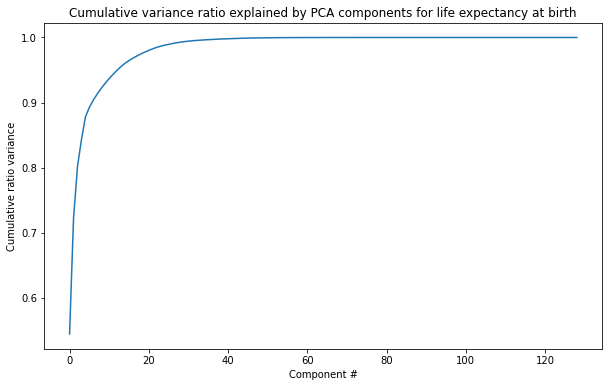

In [36]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# Create the scaler and standardize the data
scaler = StandardScaler()
x_std = scaler.fit_transform(x)

# Create the PCA instance and fit the data with pca

x_pca = PCA().fit(x_std)

# Print the cumulative sum of the explained variance ratio
#print(pc.explained_variance_ratio_.cumsum())


plt.subplots(figsize=(10, 6))
plt.plot(x_pca.explained_variance_ratio_.cumsum())
plt.xlabel('Component #')
plt.ylabel('Cumulative ratio variance')
plt.title('Cumulative variance ratio explained by PCA components for life expectancy at birth');

In [37]:
# transform() using x_std

x_pca_transform = x_pca.transform(x_std)

In [38]:
x_pca_transform.shape

(3014, 129)

In [39]:
x.columns

Index(['Unnamed: 0', 'Tract ID', 'STATE2KX_x', 'CNTY2KX', 'TRACT2KX', 'e(0)',
       'se(e(0))', 'Abridged life table flag', 'STATE2KX_y', 'STATENS',
       ...
       'CI90UB017P_2019', 'POV517_2019', 'CI90LB517_2019', 'CI90UB517_2019',
       'PCTPOV517_2019', 'CI90LB517P_2019', 'CI90UB517P_2019', 'MEDHHINC_2019',
       'CI90LBINC_2019', 'CI90UBINC_2019'],
      dtype='object', length=129)

In [42]:
# 6 principal components responsible for 89.2% of variance in dataset

x_pca.explained_variance_ratio_.cumsum()

array([0.54445262, 0.72187988, 0.80162307, 0.84305772, 0.87776053,
       0.89272361, 0.90377521, 0.91337435, 0.92185163, 0.92972549,
       0.93688249, 0.94346889, 0.94972192, 0.95542842, 0.96033764,
       0.96455454, 0.9682279 , 0.97162003, 0.9747382 , 0.97755604,
       0.98017048, 0.98266153, 0.98485901, 0.9865457 , 0.98819228,
       0.98948906, 0.99076414, 0.99190962, 0.9927922 , 0.9936448 ,
       0.99438034, 0.99497163, 0.99543456, 0.99589199, 0.99627288,
       0.99663848, 0.99699817, 0.99732176, 0.99758447, 0.99783231,
       0.99805549, 0.99827266, 0.99848183, 0.99868621, 0.99886858,
       0.99903058, 0.99916055, 0.99927611, 0.99938064, 0.99946634,
       0.99953767, 0.99960313, 0.9996602 , 0.99971292, 0.99975261,
       0.9997903 , 0.99982187, 0.99984823, 0.99987237, 0.9998946 ,
       0.99991298, 0.99992953, 0.99994077, 0.99994975, 0.99995794,
       0.99996497, 0.99997092, 0.9999759 , 0.99998022, 0.99998376,
       0.99998664, 0.99998941, 0.99999157, 0.9999931 , 0.99999

In [43]:
# list the first sixe principal components.  each component is a vector with 129 dimensions.

x_pca.components_[0:6]

array([[-7.01792048e-03, -6.75860691e-03, -6.72199847e-03,
        -6.13979701e-03, -2.96412480e-02,  1.26227578e-02,
         1.63110160e-02,  1.10468999e-04, -6.72199847e-03,
         2.09404734e-03, -6.75775123e-03, -4.65166395e-02,
        -4.03468856e-02,  4.29951711e-02,  1.18279615e-01,
         1.18232269e-01,  1.15334538e-01, -1.00196338e-02,
         1.18372272e-01,  1.18339395e-01,  1.16401720e-01,
        -8.07705438e-03,  1.18494279e-01,  1.18455206e-01,
         1.16815727e-01, -1.16742268e-03,  1.18567610e-01,
         1.18514043e-01,  1.16839672e-01, -2.46207218e-03,
         1.18615952e-01,  1.18562098e-01,  1.16767822e-01,
        -5.33688240e-03,  1.18697015e-01,  1.18637881e-01,
         1.16825682e-01, -7.45632656e-03,  1.18719734e-01,
         1.18649485e-01,  1.16569346e-01, -1.51560097e-03,
         1.18759302e-01,  1.18652679e-01,  1.16929548e-01,
         1.95687085e-03,  1.18843250e-01,  1.18726961e-01,
         1.17044991e-01,  3.41686223e-03,  1.18828204e-0

## Principal components - Feature Effects

In [44]:
df_pca = pd.DataFrame(x_pca_transform, columns = x.columns)

In [45]:
# dataframe with all principal components and feature effects.  index is number of principal components number

df_pca

,Unnamed: 0,Tract ID,STATE2KX_x,CNTY2KX,TRACT2KX,e(0),se(e(0)),Abridged life table flag,STATE2KX_y,STATENS,...,CI90UB017P_2019,POV517_2019,CI90LB517_2019,CI90UB517_2019,PCTPOV517_2019,CI90LB517P_2019,CI90UB517P_2019,MEDHHINC_2019,CI90LBINC_2019,CI90UBINC_2019
0,-0.469079,-2.602231,-3.202014,3.402117,-3.225490,-0.051665,0.210057,1.591488,0.075450,0.211947,...,-3.115639e-16,-1.073187e-15,3.473341e-16,-2.279597e-16,3.814088e-16,1.472024e-16,-3.629395e-16,-4.148745e-18,-7.119263e-16,3.042598e-16
1,2.345962,-2.638771,-2.065568,4.063771,-1.761301,-0.325961,-0.227955,1.180236,0.389485,0.296829,...,1.179017e-16,-6.930865e-16,1.374970e-16,6.991597e-17,1.973723e-16,-4.033382e-16,-3.878721e-16,2.678159e-16,-9.652365e-16,-4.557174e-16
2,-2.668875,8.868311,0.218386,2.502684,-4.087801,-1.276703,1.492857,-0.039943,0.215589,-0.189633,...,-9.137853e-16,4.098141e-16,-2.709862e-16,-3.489006e-17,-5.252075e-16,1.367055e-16,-2.916806e-16,-3.444643e-16,2.256205e-15,-8.207670e-17
3,-1.529496,2.381221,-4.270631,2.249476,-4.963497,0.671841,0.810619,-0.104071,-1.161137,0.482387,...,-3.296133e-16,-1.122309e-15,2.416512e-16,-3.416415e-16,1.423913e-16,3.946360e-16,2.715648e-16,-1.416165e-16,7.464557e-16,-6.596083e-17
4,-0.507574,-1.071757,-3.305823,2.479945,-5.306916,0.307117,-0.103395,2.026963,0.661177,0.275209,...,-2.926261e-16,-1.097845e-15,9.776568e-17,-2.719688e-16,2.027856e-16,3.996117e-16,-3.397826e-17,-6.950899e-16,6.159969e-16,8.352899e-16
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3009,-1.181625,-5.627546,1.196844,-2.266782,3.970733,-1.474959,-0.592397,0.751924,-1.275728,0.919890,...,-8.744180e-16,1.868958e-16,6.949900e-17,-5.873356e-16,-1.699788e-19,3.778179e-16,1.358385e-16,-8.997385e-16,1.074322e-15,1.852807e-15
3010,-1.126657,-8.517775,1.036665,-1.287589,5.382964,-3.647074,2.433073,0.147104,0.122891,-0.215399,...,-2.455942e-16,-1.047105e-16,3.664327e-17,-1.691461e-16,-1.698704e-16,2.818147e-16,1.061243e-16,-8.849536e-16,-5.824980e-16,4.873945e-16
3011,-2.154048,-4.261002,2.184026,-2.334668,3.662435,1.096971,0.680005,4.470124,0.037430,0.046873,...,4.314833e-16,-7.200746e-16,1.052028e-15,-7.279824e-17,-2.069629e-16,1.801020e-16,-3.473528e-16,-1.023604e-15,-1.438868e-17,7.626064e-16
3012,-2.648879,-3.242864,3.895496,-2.350376,3.234140,-1.196092,-2.257161,-1.006186,-0.688039,0.528071,...,-8.746792e-16,-7.337364e-16,1.612229e-16,2.479329e-16,-5.348709e-18,-1.100252e-16,-2.341207e-16,2.007821e-16,-3.579541e-16,-6.316079e-16


In [46]:
# pic out first principal components
pc1 = x_pca.components_[0]

pc2 = x_pca.components_[1]



In [47]:
plt.figure(figsize = (20,20))
plt.matshow((pca.components_), cmap = 'viridis')

plt.yticks([0,1], ['First component', 'Second component'])
#plt.xticks([])
plt.colorbar()
plt.xticks(range(len(df.columns)), df.columns, rotation=60, ha='left')

plt.show();

NameError: name 'pca' is not defined

<Figure size 1440x1440 with 0 Axes>

In [ ]:
plt.figure(figsize = (20,20))
plt.matshow([pc1, pc2], cmap = 'viridis')
plt.colorbar()

plt.show()


In [ ]:
# Plotly heatmap code example from Plotly documentation

import plotly.express as px
data=[[1, 25, 30, 50, 1], [20, 1, 60, 80, 30], [30, 60, 1, 5, 20]]
fig = px.imshow(data,
                labels=dict(x="Day of Week", y="Time of Day", color="Productivity"),
                x=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday'],
                y=['Morning', 'Afternoon', 'Evening']
               )
fig.update_xaxes(side="top")
fig.show()

In [ ]:
# Principal Components 1 and 2 Features Effects Plot: Plotly Version

fig = px.imshow([pc1,pc2],
               labels=dict(x="Features", y='Principal Component'),
                          x=x.columns, y = ['1', "2"])


fig.update_layout({'title': {'text': 'Principal Components 1 and 2 Effects on Dataset Features', 'xref': 'paper', 'x': 0.5}})

fig.update_layout(
    autosize=False,
    width=5000,
    height=600,)



fig.show()

## Principal Components - Feature Selection

Principal components produce an insight into how the dataset features affect the variations.
Plot the first and second principal components for the data and then use colors to represent a feature of interest.  The resulting plot visually renders the feature's effect on the dataset variation.  Distinct grouping indicate that the feature's importance in the dataset variation.  This important will be useful in modeling.

In [ ]:
#State and County Names from df_life returned to x for plotting

print(df_life.sample())

x['State'] = df_life['State']
x['County Name'] = df_life['County Name']

In [ ]:
# plotly version

fig = px.scatter(data_frame=x, x='PC 1',
                 y='PC 2', color = 'e(0)',#, size='e(0)', color='species',
                                   # Add columns to the hover information
                   hover_data=['State', 'County Name'])
                   # Add bold variable in hover information
                   #hover_name='County Name')

fig.show()

#scatterplot study using PC1 and PC2.  color by life expectancy.  plot shows higher values for life expectancy are 
# associated with high values of PC1 and low values of PC2.

In [ ]:
#scatterplot study using PC1 and PC2.   color by Median_Household_Income.   plot shows higher values for
#Median_Household_Income are associated with high values of PC1 and negative values of PC2.

# plotly version

fig = px.scatter(data_frame=x, x='PC 1',
                 y='PC 2', color = 'Median_Household_Income_2019',#, size='e(0)', color='species',
                                   # Add columns to the hover information
                   hover_data=['State', 'County Name'])
                   # Add bold variable in hover information
                   #hover_name='County Name')

fig.show()

In [ ]:
list(x.columns)


In [ ]:
#scatterplot study using PC1 and PC2.   color by overall percent of ppl living in poverty.   plot shows higher values for overall
#percent of ppl living in poverty are associated with low values of PC1 and high values of PC2.

# plotly version

fig = px.scatter(data_frame=x, x='PC 1',
                 y='PC 2', color = 'PCTPOV517_2019',#, size='e(0)', color='species',
                                   # Add columns to the hover information
                   hover_data=['State', 'County Name'])
                   # Add bold variable in hover information
                   #hover_name='County Name')

fig.show()

# Exploratory Data Analysis Conclusion

## Pearson correlation coefficients

Pearson correlation coefficients between all numerical features were calculated.  The correlation coefficients between life expectancy at birth and all other numerical features were collected and sorted according to numerical value.

This produces a list of the most positively and negatively correlated features with life expectancy.

1.  Negative correlation Factors:
 
 | Feature Name | Life Expectancy at Birth Calculated Correlation  |
 |:--|:--|
 |Percent of adults with less than a high school diploma, 1990|   -0.584382|
 |Percent of adults with less than a high school diploma, 1980|   -0.572791|
 |PCTPOV017_2019                                               |  -0.569323|
 |CI90LB017P_2019                                               | -0.565918|
 |PCTPOV517_2019                                                 |-0.563010|
 |CI90UB017P_2019                                                |-0.561221|
 |Percent of adults with less than a high school diploma, 2000   |-0.559261|
 |CI90UB517P_2019                                                |-0.556364|
 |CI90LB517P_2019 |                                               -0.553192|
 |PCTPOVALL_2019|-0.552171|

2.  Positive Correlation Factors

 | Feature Name | Life Expectancy at Birth Calculated Correlation  |
 |:--|:--|
| e(0)                                                                     |1.000000|
 |CI90UBINC_2019                                                           |0.539239|
 |MEDHHINC_2019                                                            |0.526200|
 |Median_Household_Income_2019                                             |0.526200|
 |Percent of adults completing some college (1-3 years), 1980              |0.526066|
 |CI90LBINC_2019                                                           |0.507359|
 |Percent of adults completing some college (1-3 years), 1970              |0.505921|
 |Percent of adults completing some college or associate's degree, 1990    |0.479895|
 |Percent of adults with a bachelor's degree or higher, 2015-19            |0.467264|
 |Percent of adults with a bachelor's degree or higher, 2000               |0.466194|





## Principal Component Analysis-
    
  The initial steps of principal component analysis (PCA) involves removing categorical features and scaling the 
numerical features of the dataset.  PCA is then fitted to the scaled data.  The scaled data is then transformed to produce a list of numerical vectors.  Each vector represents a principal component and the order of the list reflects the strength of the principal component effect on the data variation.

Six principal component vectors are responsible for 90% of the variation in the data.  Seventy-two percent of the
dataset variation is due to the first two principal components.

### PCA Feature Effects

1.  A heatmap of the feature effects of first two principal components shows a mix of moderate positive and negative values.  This indicates that no individual feature is signficantly affecting the variation more than the other features.

### PCA Feature Selection

2.  Scatterplot of Principal Components 1 (PC 1) and Principal Component 2 (PC 2) yields information on how particular features affect the life expectancy.
    
- scatterplot shows higher values for life expectancy are associated with high values of PC1 and low values of <br> PC2.  
- scatterplot shows higher values for Median_Household_Income are associated with high values of PC1 and negative values of PC2.
- scatterplot shows higher values for overall percent of ppl living in poverty are associated with low values of PC1 and high values of PC2.

